# Captchas Recognition
## Wprowadzenie

W dzisiejszych czasach, gdy internet odgrywa kluczową rolę w naszym codziennym życiu, ochrona danych online stała się niezwykle ważna. Jednym ze sposobów zabezpieczania witryn internetowych przed działaniami automatycznymi i nieautoryzowanymi atakami jest stosowanie testów CAPTCHA (Completely Automated Public Turing test to tell Computers and Humans Apart). CAPTCHA polega na wyświetlaniu użytkownikowi serii obrazków lub znaków, które ma on zidentyfikować, aby potwierdzić, że jest człowiekiem, a nie botem.

W ramach tego projektu skupimy się na rozpoznawaniu obrazków CAPTCHA, co stanowi wyzwanie dla algorytmów komputerowych. Celem naszego projektu będzie stworzenie skutecznego modelu, który będzie w stanie automatycznie rozpoznawać obrazy CAPTCHA.

W trakcie realizacji tego projektu będziemy wykorzystywać techniki głębokiego uczenia, które są znane ze swojej zdolności do przetwarzania i analizy obrazów. Skorzystamy z dostępnych zbiorów danych CAPTCHA, które posłużą nam do trenowania i testowania modeli uczenia maszynowego. Przebadamy różne architektury sieci neuronowych, takie jak konwolucyjne sieci neuronowe (CNN), rekurencyjne sieci neuronowe (RNN) i połączenia tych dwóch typów, aby znaleźć optymalne rozwiązanie dla naszego zadania.
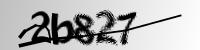

## Zbiór danych
Do treningu modeli wykorzystamy zbiór Captcha Images z Kaggle. W przypadku, gdy zauważymy, że brakuje danych będziemy mogli je dogenerować za pomocą narzędzi dostępnych w internecie. 
### Kontekst
Ten zbiór danych zawiera obrazy CAPTCHA (Completely Automated Public Turing test to tell Computers and Humans Apart). Powstały one w 1997 roku jako sposób dla użytkowników do identyfikowania i blokowania botów (w celu zapobiegania spamowi, atakom typu DDOS itp.). Od tamtej pory zostały zastąpione przez reCAPTCHA, ponieważ można je łamać przy użyciu sztucznej inteligencji (co będzie celem tego notebooka).

### Zawartość
Zbiór składa się z 1070 obrazów. Obrazy te to 5-literowe słowa, które mogą zawierać cyfry. Obrazy te zostały poddane zaszumieniu (rozmyciu i linii). Są to pliki PNG o rozmiarze 200 x 50 pikseli. 
Etykietą dla każdego obrazka jest string - nazwa pliku.

## Przygotowanie danych
### Import potrzebnych bibliotek

In [1]:
import os
import numpy as np
import matplotlib.pyplot as plt

import string
from pathlib import Path

import tensorflow as tf
from tensorflow import keras
from tensorflow.keras import layers
from tensorflow.keras import models

import matplotlib.pyplot as plt

## Zakodowanie etykiet
Zmapujemy każdą literę, cyfrę w etykiecie jako `int`. Tak samo potrzebujemy zmapować predykcje modelu spowrotem do string'a. W tym celu będziemy mieli dwa słowniki:
* znak -> int
* int -> znak

In [2]:
data_dir = Path("./dataset/samples/")

images_paths = sorted(list(map(str, list(data_dir.glob("*.png")))))
labels = [img_path.split(os.path.sep)[-1].split(".png")[0] for img_path in images_paths]
characters = set(char for label in labels for char in label)
characters = sorted(list(characters))

print("Number of images found: ", len(images_paths))
print("Number of labels found: ", len(labels))
print("Number of unique characters: ", len(characters))
print("Characters present: ", characters)

batch_size = 16

img_width = 200
img_height = 50

downsample_factor = 4

max_length = max([len(label) for label in labels])

Number of images found:  1040
Number of labels found:  1040
Number of unique characters:  19
Characters present:  ['2', '3', '4', '5', '6', '7', '8', 'b', 'c', 'd', 'e', 'f', 'g', 'm', 'n', 'p', 'w', 'x', 'y']


Jak widzimy powyżej, liczba unikalnych znaków w naszym zbiorze wynosi 19. Jednak jako, że chcemy aby nasz model był uniwersalny weźmiemy wszystkie znaki jakie są w słowniku:

In [3]:
characters = string.ascii_lowercase + "0123456789"
characters = set(char for char in characters)
characters = sorted(list(characters))
print("Number of unique characters: ", len(characters))
print("Characters present: ", characters)

Number of unique characters:  36
Characters present:  ['0', '1', '2', '3', '4', '5', '6', '7', '8', '9', 'a', 'b', 'c', 'd', 'e', 'f', 'g', 'h', 'i', 'j', 'k', 'l', 'm', 'n', 'o', 'p', 'q', 'r', 's', 't', 'u', 'v', 'w', 'x', 'y', 'z']


### Funkcja kodująca przykłady uczące:

In [4]:
char_to_num = layers.StringLookup(
    vocabulary=list(characters), mask_token=None
)

num_to_char = layers.StringLookup(
    vocabulary=char_to_num.get_vocabulary(), mask_token=None, invert=True
)

def encode_single_sample(img_path, label):
    img = tf.io.read_file(img_path)
    img = tf.io.decode_png(img, channels=1)
    img = tf.image.convert_image_dtype(img, tf.float32)
    img = tf.image.resize(img, [img_height, img_width])
    # Transponujmy obraz, ponieważ chcemy mieć zachowany wymiar czasu
    img = tf.transpose(img, perm=[1, 0, 2])
    label = char_to_num(tf.strings.unicode_split(label, input_encoding="UTF-8"))
    return img, label

In [5]:
print("Vocabulary: ", char_to_num.get_vocabulary())

Vocabulary:  ['[UNK]', '0', '1', '2', '3', '4', '5', '6', '7', '8', '9', 'a', 'b', 'c', 'd', 'e', 'f', 'g', 'h', 'i', 'j', 'k', 'l', 'm', 'n', 'o', 'p', 'q', 'r', 's', 't', 'u', 'v', 'w', 'x', 'y', 'z']


Image path:  dataset\samples\226md.png
Label:  226md


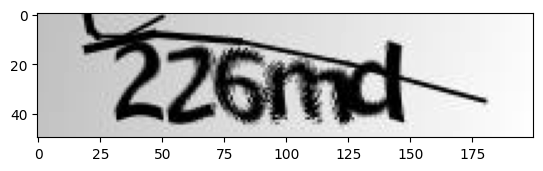

Label encoded:  tf.Tensor([ 3  3  7 23 14], shape=(5,), dtype=int64)


In [6]:
image_path = images_paths[0]
label = labels[0]
print("Image path: ", image_path)
print("Label: ", label)

img_encoded, label_encoded = encode_single_sample(image_path, label)
plt.imshow(img_encoded.numpy().transpose((1,0,2)), 'gray')
plt.show()
print('Label encoded: ', label_encoded)

Widzimy, że funkcja wczytuje obraz i przekształca go w obraz w odcieniach szarości, a także koduje etykietę według słownika zdefiniowanego powyżej 

## Preprocesing

In [7]:
def split_data(images_paths, labels, train_size=0.9, shuffle=True):
    size = len(images_paths)
    indices = np.arange(size)
    if shuffle:
        np.random.shuffle(indices)
    train_samples = int(size * train_size)
    x_train, y_train = images_paths[indices[:train_samples]], labels[indices[:train_samples]]
    x_valid, y_valid = images_paths[indices[train_samples:]], labels[indices[train_samples:]]
    return x_train, x_valid, y_train, y_valid


x_train, x_valid, y_train, y_valid = split_data(np.array(images_paths), np.array(labels))

## Utwórzmy zbiór trenujący i uczący

In [8]:
def create_dataset(paths, labels):
    X , y =[], []
    for i in range(paths.shape[0]):
        img, label = encode_single_sample(paths[i], labels[i])
        X.append(img)
        y.append(label)
    X = np.array(X)
    y = np.array(y)
    return X, y

X_train, y_train = create_dataset(x_train, y_train)
X_valid, y_valid = create_dataset(x_valid, y_valid)

## Popatrzmy na nasz zbiór danych

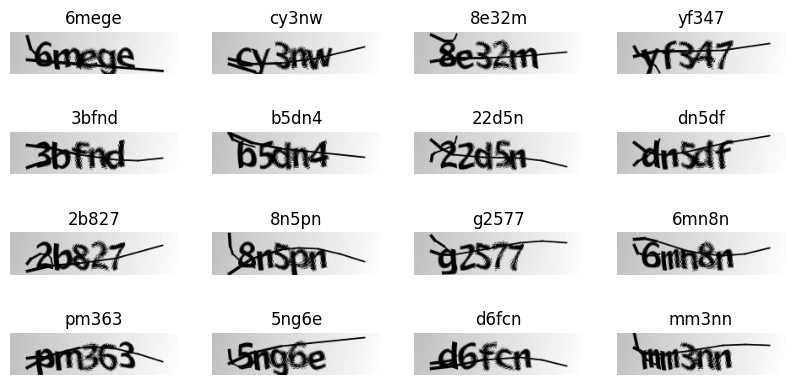

In [9]:
_, ax = plt.subplots(4, 4, figsize=(10, 5))
for i in range(16):
    img = (X_train[i] * 255).astype("uint8")
    label = tf.strings.reduce_join(num_to_char(y_train[i])).numpy().decode("utf-8")
    ax[i // 4, i % 4].imshow(img.transpose([1, 0, 2]), cmap="gray")
    ax[i // 4, i % 4].set_title(label)
    ax[i // 4, i % 4].axis("off")
plt.show()

## Definicja funkcji rysujących wykresy
Po pierwsze zdefiniujmy funkcje, które będą używane do wykreślania osiągniętych wyników:

In [10]:
def PlotAccuracyComparison(acc, val_acc, lab = ''):
    plt.clf()   # clear figure
    #plt.rcParams['figure.figsize'] = (15.0, 5.0) # set default size of plots
    plt.figure(figsize=(15,5))
    #plt_inline()
    epochs = range(len(acc))
    plt.plot(epochs, acc, 'bo', label='Training accuracy for ' + lab)
    plt.plot(epochs, val_acc, 'b', label='Validation accuracy for ' + lab)
    plt.title('Comparison of Training and Validation Accuracies')
    plt.xlabel('Epochs')
    plt.ylabel('Accuracy')
    plt.legend(['Train ' + lab, 'Test ' + lab], loc='upper left')
    plt.show()

def PlotLossComparison(loss, val_loss, lab = ''):
    plt.clf()   # clear figure
    #plt.rcParams['figure.figsize'] = (15.0, 5.0) # set default size of plots
    plt.figure(figsize=(15,5))
    #plt_inline()
    epochs = range(len(loss))
    plt.plot(epochs, loss, 'bo', label='Training loss for ' + lab)
    plt.plot(epochs, val_loss, 'b', label='Validation loss for ' + lab)
    plt.title('Comparison of Training and Validation Losses')
    plt.xlabel('Epochs')
    plt.ylabel('Loss')
    plt.legend(['Train ' + lab, 'Test ' + lab], loc='upper left')
    plt.show()

def PlotTwoAccuracyComparison(acc1, val_acc1, acc2, val_acc2, lab1 = 'Model 1', lab2 = 'Model 2'):
    plt.clf()   # clear figure
    #plt.rcParams['figure.figsize'] = (15.0, 5.0) # set default size of plots
    plt.figure(figsize=(15,5))
    #plt_inline()
    epochs = range(len(acc1))
    plt.plot(epochs, acc1, 'bo', label='Training accuracy for ' + lab1)
    plt.plot(epochs, val_acc1, 'b', label='Validation accuracy for ' + lab1)
    plt.plot(epochs, acc2, 'ro', label='Training accuracy for ' + lab2)
    plt.plot(epochs, val_acc2, 'r', label='Validation accuracy for ' + lab2)
    plt.title('Comparison of Training and Validation Accuracies')
    plt.xlabel('Epochs')
    plt.ylabel('Accuracy')
    plt.legend(['Train '+ lab1, 'Test ' + lab1, 'Train '+ lab2, 'Test ' + lab2], loc='upper left')
    plt.show()

def PlotTwoLossComparison(loss1, val_loss1, loss2, val_loss2, lab1 = 'Model 1', lab2 = 'Model 2'):
    plt.clf()   # clear figure
    #plt.rcParams['figure.figsize'] = (15.0, 5.0) # set default size of plots
    plt.figure(figsize=(15,5))
    #plt_inline()
    epochs = range(len(loss1))
    plt.plot(epochs, loss1, 'bo', label='Training loss for ' + lab1)
    plt.plot(epochs, val_loss1, 'b', label='Validation loss for ' + lab1)
    plt.plot(epochs, loss2, 'ro', label='Training loss for ' + lab2)
    plt.plot(epochs, val_loss2, 'r', label='Validation loss for ' + lab2)
    plt.title('Comparison of Training and Validation Losses')
    plt.xlabel('Epochs')
    plt.ylabel('Loss')
    plt.legend(['Train '+ lab1, 'Test ' + lab1, 'Train '+ lab2, 'Test ' + lab2], loc='upper left')
    plt.show()

## Wizualizacje pośrednich aktywacji
Wizualizacja pośrednich aktywacji polega na wyświetlaniu map cech, które są generowane przez różne warstwy splotowe (konwolucyjne) i poolingu w sieci dla określonego wejścia. Wyjście warstwy jest często nazywane jej <b>aktywacją</b>, tj. wyjściem funkcji aktywacji. Daje nam to wgląd w to, jak dane wejściowe są rozkładane na różne filtry wyuczone przez sieć. Możemy też zauważyć te filtry, które nie zostały jeszcze dobrze zaadaptowane. Te mapy obiektów, które chcemy zwizualizować, mają 3 wymiary: szerokość, wysokość i głębokość (3 kanały). Każdy kanał koduje stosunkowo niezależne funkcje, więc właściwym sposobem wizualizacji tych map cech jest niezależne wykreślenie zawartości każdego kanału jako obrazu 2D.

Wizualizacja wyjść pozwala nam też na wykrycie <b>„martwych” komórek (neuronów)</b>, które nie biorą udziału (lub w bardzo ograniczonym stopniu) w procesie klasyfikacji i uczenia, ponieważ rzadko lub nigdy nie wygrywają w rywalizacji z innymi filtrami w warstwach MaxPooling. Może to wyglądać jak <b>choroba Alzheimera lub Parkinsona struktury CNN</b>. Jest to bardzo istotne z punktu widzenia rozróżniania i wydajności, ponieważ "martwe" komórki ograniczają pojemność i zdolność trenowania modelu, zwiększając pamięć i zużycie energii, nie robiąc nic pożytecznego! Jeżeli na wyjściu filtru widzimy reakcję zerową, powinniśmy sprawdzić powiązany z nim filtr, czy reprezentuje on jakiś sensowny wzór, czy tylko biały szum generowany przez liczby pseudolosowe podczas inicjalizacji wagi. Jeśli biały szum, to oznacza to, że filtr prawdopodobnie nie był modyfikowany od początku procesu uczenia i taki filtr jest nieprzydatny („martwy”).

In [42]:
# These are the names of the layers, so can have them as part of our plot
def output_visualization(model, img_tensor, number_of_layers):
    # Extracts the outputs of the top 15 layers:
    layer_outputs = [layer.output for layer in model.layers[:number_of_layers]]

    # Creates a model that will return these outputs, given the model input:
    activation_model = models.Model(inputs=model.input, outputs=layer_outputs)
    
    # This will return a list of 5 Numpy arrays:
    # one array per layer activation
    activations = activation_model.predict(img_tensor)

    layer_names = []
    for layer in model.layers[:number_of_layers]:
        layer_names.append(layer.name)

    images_per_row = 16

    activations_images = dict()

    # Now let's display our feature maps
    for layer_name, layer_activation in zip(layer_names, activations):
        # This is the number of features (channels) in the feature map
        n_features = layer_activation.shape[-1]

        # The feature map has shape (1, size, size, n_features)
        col_size = layer_activation.shape[1]
        row_size = layer_activation.shape[2]
        
        # We will tile the activation channels in this matrix
        n_cols = n_features // images_per_row
        display_grid = np.zeros((col_size * n_cols, row_size * images_per_row))

        layer_images = list()

        # We'll tile each filter into this big horizontal grid
        for col in range(n_cols):
            for row in range(images_per_row):
                channel_image = layer_activation[0, :, :, col * images_per_row + row]

                # Post-process the feature to make it visually palatable
                channel_image -= channel_image.mean()
                channel_image /= channel_image.std()
                channel_image *= 64
                channel_image += 128
                channel_image = np.clip(channel_image, 0, 255).astype('uint8')
                layer_images.append(channel_image)
                display_grid[col * col_size : (col + 1) * col_size, row * row_size : (row + 1) * row_size] = channel_image

        activations_images[layer_name] = layer_images           

        # Display the grid
        row_scale = 1. / row_size
        col_scale = 1. / col_size
        plt.figure(figsize=(row_scale * display_grid.shape[1], col_scale * display_grid.shape[0]))
        plt.title(layer_name)
        plt.grid(False)
        plt.imshow(display_grid, aspect='auto', cmap='viridis')

    plt.show()

    return activations_images

# Modele

In [83]:
def build_model():
    
    model = keras.Sequential()
    model.add(layers.Input(shape=(200, 50 ,1), name="image", dtype="float32"))

    model.add(layers.Conv2D(32,(3, 3), activation="relu",kernel_initializer="he_normal",padding="same",name="Conv1"))
    model.add(layers.MaxPooling2D((2, 2), name="pool1"))

    model.add(layers.Conv2D(64,(3, 3),activation="relu",kernel_initializer="he_normal",padding="same",name="Conv2"))
    model.add(layers.MaxPooling2D((2, 2), name="pool2"))

    model.add(layers.Reshape(target_shape=(5, 7680), name="reshape"))

    model.add(layers.Dense(256, activation="relu", name="dense1"))
    model.add(layers.Dense(64, activation="relu", name="dense2"))
   
    model.add(layers.Dense(36, activation="softmax", name="dense3")) 
    
    model.compile(optimizer=keras.optimizers.Adam(), loss="sparse_categorical_crossentropy", metrics="accuracy")
    return model


model = build_model()
model.summary()

Model: "sequential_4"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 Conv1 (Conv2D)              (None, 200, 50, 32)       320       
                                                                 
 pool1 (MaxPooling2D)        (None, 100, 25, 32)       0         
                                                                 
 Conv2 (Conv2D)              (None, 100, 25, 64)       18496     
                                                                 
 pool2 (MaxPooling2D)        (None, 50, 12, 64)        0         
                                                                 
 reshape (Reshape)           (None, 5, 7680)           0         
                                                                 
 dense1 (Dense)              (None, 5, 256)            1966336   
                                                                 
 dense2 (Dense)              (None, 5, 64)            

In [21]:
def build_model():
    
    model = keras.Sequential()

    model.add(layers.Conv2D(32,(3, 3), activation="relu", padding="same", name="Conv1", input_shape=X_train.shape[1:]))
    model.add(layers.MaxPooling2D((2, 2), name="pool1"))

    model.add(layers.Reshape(target_shape=(5, 16000), name="reshape"))

    model.add(layers.Dense(256, activation="relu", name="dense1"))
   
    model.add(layers.Dense(36, activation="softmax", name="dense2")) 
    
    model.compile(optimizer=keras.optimizers.Adam(), loss="sparse_categorical_crossentropy", metrics="accuracy")
    return model


model = build_model()
model.summary()

Model: "sequential_2"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 Conv1 (Conv2D)              (None, 200, 50, 32)       320       
                                                                 
 pool1 (MaxPooling2D)        (None, 100, 25, 32)       0         
                                                                 
 reshape (Reshape)           (None, 5, 16000)          0         
                                                                 
 dense1 (Dense)              (None, 5, 256)            4096256   
                                                                 
 dense2 (Dense)              (None, 5, 36)             9252      
                                                                 
Total params: 4,105,828
Trainable params: 4,105,828
Non-trainable params: 0
_________________________________________________________________


In [22]:
history = model.fit(X_train, y_train,
                    validation_data=(X_valid, y_valid),
                    batch_size=32,
                    epochs=30)

Epoch 1/30
30/30 [==============================] - 7s 23ms/step - loss: 3.0974 - accuracy: 0.0966 - val_loss: 2.8107 - val_accuracy: 0.1173
Epoch 2/30
30/30 [==============================] - 0s 13ms/step - loss: 2.5712 - accuracy: 0.2835 - val_loss: 2.4390 - val_accuracy: 0.3538
Epoch 3/30
30/30 [==============================] - 0s 14ms/step - loss: 2.1606 - accuracy: 0.4278 - val_loss: 2.2150 - val_accuracy: 0.3904
Epoch 4/30
30/30 [==============================] - 0s 14ms/step - loss: 1.8749 - accuracy: 0.4838 - val_loss: 2.0383 - val_accuracy: 0.4423
Epoch 5/30
30/30 [==============================] - 0s 13ms/step - loss: 1.6838 - accuracy: 0.5321 - val_loss: 1.9848 - val_accuracy: 0.4712
Epoch 6/30
30/30 [==============================] - 0s 13ms/step - loss: 1.5501 - accuracy: 0.5635 - val_loss: 1.8733 - val_accuracy: 0.5096
Epoch 7/30
30/30 [==============================] - 0s 13ms/step - loss: 1.4335 - accuracy: 0.5927 - val_loss: 1.8560 - val_accuracy: 0.5115
Epoch 8/30
30

<Figure size 640x480 with 0 Axes>

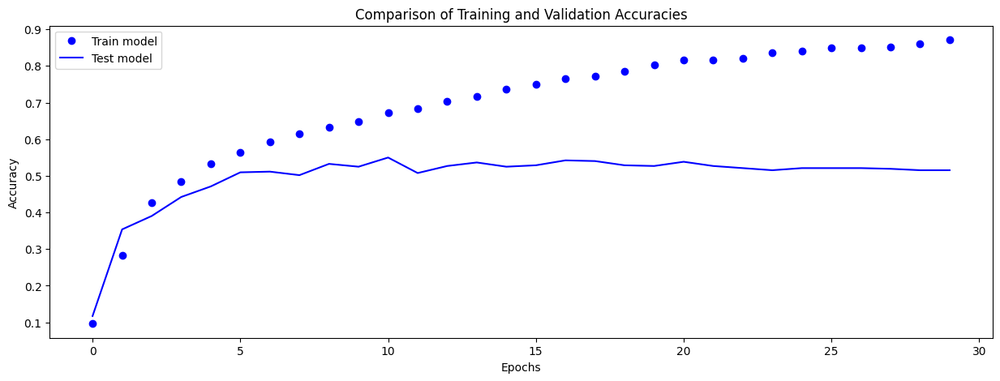

<Figure size 640x480 with 0 Axes>

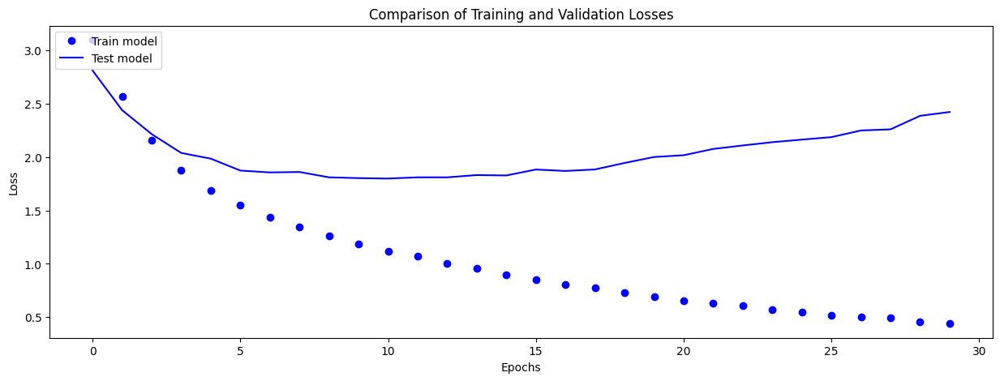

In [23]:
acc_model = history.history['accuracy']
val_acc_model = history.history['val_accuracy']
loss_model = history.history['loss']
val_loss_model = history.history['val_loss']

PlotAccuracyComparison(acc_model, val_acc_model, lab = 'model')
PlotLossComparison(loss_model, val_loss_model, lab = 'model')

Po około 5 epokach nasz model zaczyna nam się przetrenowywać. Wyniki jakie osiągmy to 52% skuteczności na zbiorze testowym. Jednak w naszym pierwszym modelu wykorzystaliśmy tylko jedną warstwę konwolucyjną przez co na warstwie `Reshape` mieliśmy ogromną liczbę neuronów dla każdego znaku. Dołóżmy teraz jeszcze jedną warstwę konwolucyjną:

In [25]:
def build_model():
    
    model = keras.Sequential()

    model.add(layers.Conv2D(32, (3, 3), activation="relu", padding="same", name="Conv1", input_shape=X_train.shape[1:]))
    model.add(layers.MaxPooling2D((2, 2), name="pool1"))
    
    model.add(layers.Conv2D(64, (3, 3), activation="relu", padding="same", name="Conv2"))
    model.add(layers.MaxPooling2D((2, 2), name="pool2"))

    model.add(layers.Reshape(target_shape=(5, 7680), name="reshape"))

    model.add(layers.Dense(256, activation="relu", name="dense1"))
   
    model.add(layers.Dense(36, activation="softmax", name="dense2")) 
    
    model.compile(optimizer=keras.optimizers.Adam(), loss="sparse_categorical_crossentropy", metrics="accuracy")
    return model


model = build_model()
model.summary()

Model: "sequential_4"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 Conv1 (Conv2D)              (None, 200, 50, 32)       320       
                                                                 
 pool1 (MaxPooling2D)        (None, 100, 25, 32)       0         
                                                                 
 Conv2 (Conv2D)              (None, 100, 25, 64)       18496     
                                                                 
 pool2 (MaxPooling2D)        (None, 50, 12, 64)        0         
                                                                 
 reshape (Reshape)           (None, 5, 7680)           0         
                                                                 
 dense1 (Dense)              (None, 5, 256)            1966336   
                                                                 
 dense2 (Dense)              (None, 5, 36)            

In [26]:
history = model.fit(X_train, y_train,
                    validation_data=(X_valid, y_valid),
                    batch_size=32,
                    epochs=30)

Epoch 1/30
30/30 [==============================] - 2s 27ms/step - loss: 2.9697 - accuracy: 0.1096 - val_loss: 2.7677 - val_accuracy: 0.1577
Epoch 2/30
30/30 [==============================] - 0s 16ms/step - loss: 2.4692 - accuracy: 0.3004 - val_loss: 2.2775 - val_accuracy: 0.3500
Epoch 3/30
30/30 [==============================] - 0s 17ms/step - loss: 1.9274 - accuracy: 0.4479 - val_loss: 1.8920 - val_accuracy: 0.4904
Epoch 4/30
30/30 [==============================] - 0s 16ms/step - loss: 1.6001 - accuracy: 0.5368 - val_loss: 1.7342 - val_accuracy: 0.5173
Epoch 5/30
30/30 [==============================] - 1s 17ms/step - loss: 1.4084 - accuracy: 0.5818 - val_loss: 1.6448 - val_accuracy: 0.5250
Epoch 6/30
30/30 [==============================] - 0s 16ms/step - loss: 1.2810 - accuracy: 0.6154 - val_loss: 1.5880 - val_accuracy: 0.5538
Epoch 7/30
30/30 [==============================] - 0s 17ms/step - loss: 1.1803 - accuracy: 0.6387 - val_loss: 1.5842 - val_accuracy: 0.5692
Epoch 8/30
30

<Figure size 640x480 with 0 Axes>

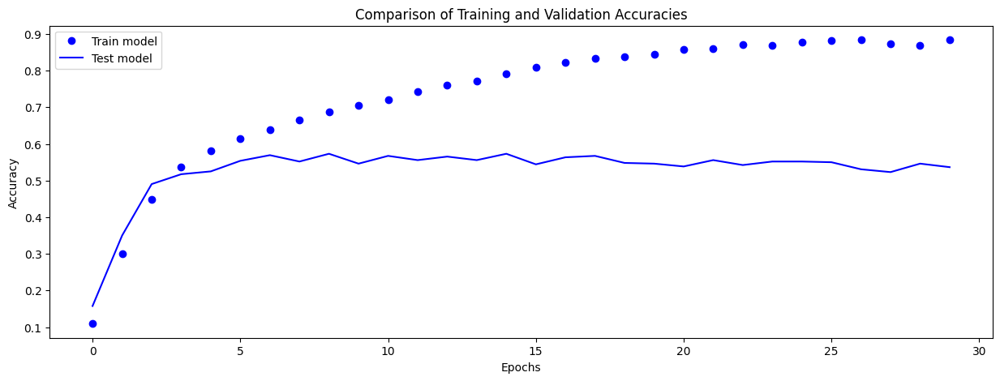

<Figure size 640x480 with 0 Axes>

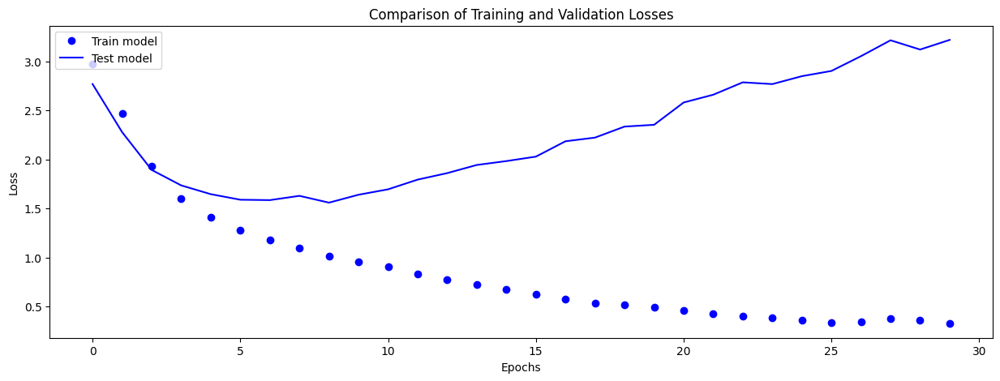

In [27]:
acc_model = history.history['accuracy']
val_acc_model = history.history['val_accuracy']
loss_model = history.history['loss']
val_loss_model = history.history['val_loss']

PlotAccuracyComparison(acc_model, val_acc_model, lab = 'model')
PlotLossComparison(loss_model, val_loss_model, lab = 'model')

Nie spowodowało to usunięcia overfittingu, aczkolwiek poprawiło wyniki na zbiorze walidacyjnym o około 2%. Dołóżmy jeszcze jedną warstwę konwolucyjną:

In [29]:
def build_model():
    
    model = keras.Sequential()

    model.add(layers.Conv2D(32, (3, 3), activation="relu", padding="same", name="Conv1", input_shape=X_train.shape[1:]))
    model.add(layers.MaxPooling2D((2, 2), name="pool1"))
    
    model.add(layers.Conv2D(64, (3, 3), activation="relu", padding="same", name="Conv2"))
    model.add(layers.MaxPooling2D((2, 2), name="pool2"))
    
    model.add(layers.Conv2D(128, (3, 3), activation="relu", padding="same", name="Conv3"))
    model.add(layers.MaxPooling2D((2, 2), name="pool3"))

    model.add(layers.Reshape(target_shape=(5, 3840), name="reshape"))

    model.add(layers.Dense(256, activation="relu", name="dense1"))
   
    model.add(layers.Dense(36, activation="softmax", name="dense2")) 
    
    model.compile(optimizer=keras.optimizers.Adam(), loss="sparse_categorical_crossentropy", metrics="accuracy")
    return model


model = build_model()
model.summary()

Model: "sequential_6"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 Conv1 (Conv2D)              (None, 200, 50, 32)       320       
                                                                 
 pool1 (MaxPooling2D)        (None, 100, 25, 32)       0         
                                                                 
 Conv2 (Conv2D)              (None, 100, 25, 64)       18496     
                                                                 
 pool2 (MaxPooling2D)        (None, 50, 12, 64)        0         
                                                                 
 Conv3 (Conv2D)              (None, 50, 12, 128)       73856     
                                                                 
 pool3 (MaxPooling2D)        (None, 25, 6, 128)        0         
                                                                 
 reshape (Reshape)           (None, 5, 3840)          

In [30]:
history = model.fit(X_train, y_train,
                    validation_data=(X_valid, y_valid),
                    batch_size=32,
                    epochs=30)

Epoch 1/30
30/30 [==============================] - 2s 30ms/step - loss: 3.0366 - accuracy: 0.0889 - val_loss: 2.9081 - val_accuracy: 0.1019
Epoch 2/30
30/30 [==============================] - 1s 20ms/step - loss: 2.7810 - accuracy: 0.1590 - val_loss: 2.4843 - val_accuracy: 0.3135
Epoch 3/30
30/30 [==============================] - 1s 20ms/step - loss: 2.2037 - accuracy: 0.3759 - val_loss: 2.0124 - val_accuracy: 0.4462
Epoch 4/30
30/30 [==============================] - 1s 19ms/step - loss: 1.6962 - accuracy: 0.5107 - val_loss: 1.6977 - val_accuracy: 0.5077
Epoch 5/30
30/30 [==============================] - 1s 20ms/step - loss: 1.4071 - accuracy: 0.5872 - val_loss: 1.5342 - val_accuracy: 0.5500
Epoch 6/30
30/30 [==============================] - 1s 20ms/step - loss: 1.2216 - accuracy: 0.6329 - val_loss: 1.4398 - val_accuracy: 0.5692
Epoch 7/30
30/30 [==============================] - 1s 20ms/step - loss: 1.1148 - accuracy: 0.6579 - val_loss: 1.4172 - val_accuracy: 0.5788
Epoch 8/30
30

<Figure size 640x480 with 0 Axes>

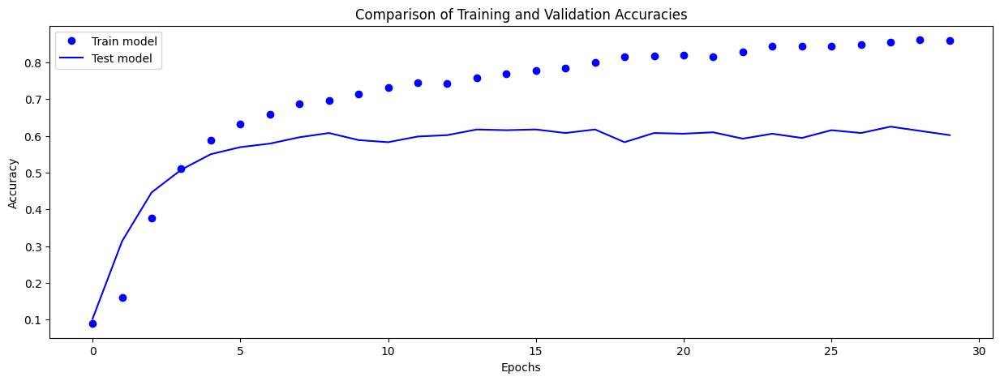

<Figure size 640x480 with 0 Axes>

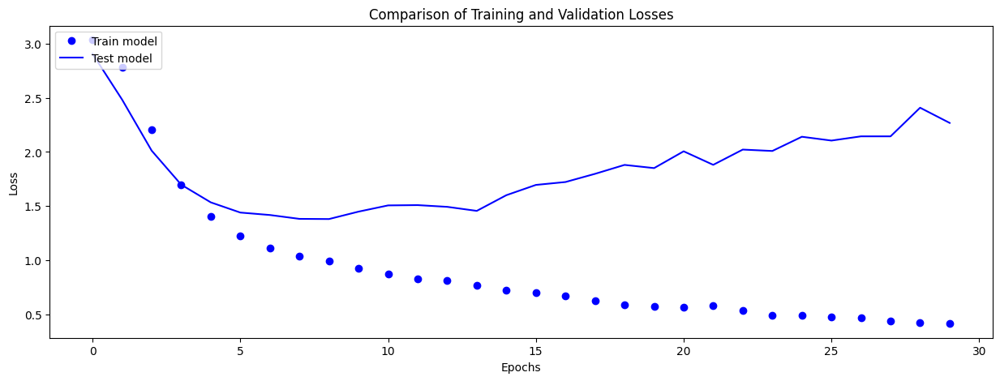

In [31]:
acc_model = history.history['accuracy']
val_acc_model = history.history['val_accuracy']
loss_model = history.history['loss']
val_loss_model = history.history['val_loss']

PlotAccuracyComparison(acc_model, val_acc_model, lab = 'model')
PlotLossComparison(loss_model, val_loss_model, lab = 'model')

Model nie przeucza się już tak znacznie jak to było wcześniej. Spróbujmy dołożyć jeszcze jedną warswę Dense

In [32]:
def build_model():
    
    model = keras.Sequential()

    model.add(layers.Conv2D(32, (3, 3), activation="relu", padding="same", name="Conv1", input_shape=X_train.shape[1:]))
    model.add(layers.MaxPooling2D((2, 2), name="pool1"))
    
    model.add(layers.Conv2D(64, (3, 3), activation="relu", padding="same", name="Conv2"))
    model.add(layers.MaxPooling2D((2, 2), name="pool2"))
    
    model.add(layers.Conv2D(128, (3, 3), activation="relu", padding="same", name="Conv3"))
    model.add(layers.MaxPooling2D((2, 2), name="pool3"))

    model.add(layers.Reshape(target_shape=(5, 3840), name="reshape"))

    model.add(layers.Dense(256, activation="relu", name="dense1"))
    model.add(layers.Dense(128, activation="relu", name="dense2"))
   
    model.add(layers.Dense(36, activation="softmax", name="dense3")) 
    
    model.compile(optimizer=keras.optimizers.Adam(), loss="sparse_categorical_crossentropy", metrics="accuracy")
    return model


model = build_model()
model.summary()

Model: "sequential_7"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 Conv1 (Conv2D)              (None, 200, 50, 32)       320       
                                                                 
 pool1 (MaxPooling2D)        (None, 100, 25, 32)       0         
                                                                 
 Conv2 (Conv2D)              (None, 100, 25, 64)       18496     
                                                                 
 pool2 (MaxPooling2D)        (None, 50, 12, 64)        0         
                                                                 
 Conv3 (Conv2D)              (None, 50, 12, 128)       73856     
                                                                 
 pool3 (MaxPooling2D)        (None, 25, 6, 128)        0         
                                                                 
 reshape (Reshape)           (None, 5, 3840)          

In [33]:
history = model.fit(X_train, y_train,
                    validation_data=(X_valid, y_valid),
                    batch_size=32,
                    epochs=30)

Epoch 1/30
30/30 [==============================] - 2s 28ms/step - loss: 3.0969 - accuracy: 0.0791 - val_loss: 2.9481 - val_accuracy: 0.1000
Epoch 2/30
30/30 [==============================] - 1s 20ms/step - loss: 2.9099 - accuracy: 0.1058 - val_loss: 2.8329 - val_accuracy: 0.1346
Epoch 3/30
30/30 [==============================] - 1s 20ms/step - loss: 2.6411 - accuracy: 0.1964 - val_loss: 2.3857 - val_accuracy: 0.3404
Epoch 4/30
30/30 [==============================] - 1s 20ms/step - loss: 2.0779 - accuracy: 0.3959 - val_loss: 1.9034 - val_accuracy: 0.4538
Epoch 5/30
30/30 [==============================] - 1s 20ms/step - loss: 1.6399 - accuracy: 0.5077 - val_loss: 1.6343 - val_accuracy: 0.5077
Epoch 6/30
30/30 [==============================] - 1s 20ms/step - loss: 1.3913 - accuracy: 0.5818 - val_loss: 1.5066 - val_accuracy: 0.5692
Epoch 7/30
30/30 [==============================] - 1s 20ms/step - loss: 1.2358 - accuracy: 0.6267 - val_loss: 1.4346 - val_accuracy: 0.5808
Epoch 8/30
30

<Figure size 640x480 with 0 Axes>

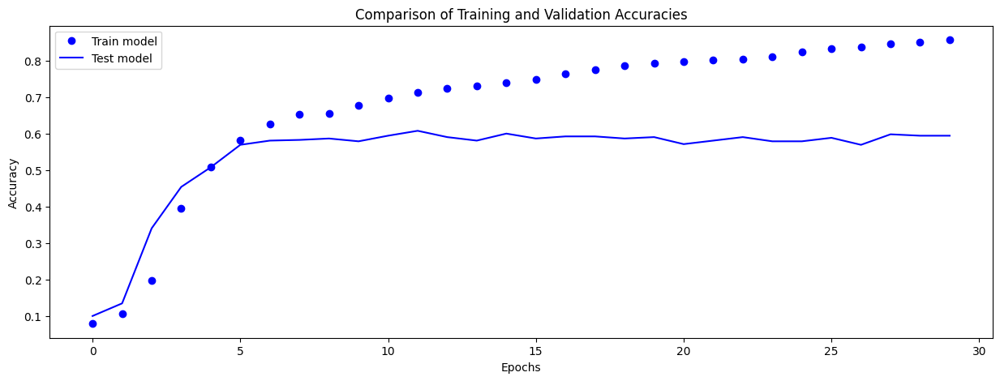

<Figure size 640x480 with 0 Axes>

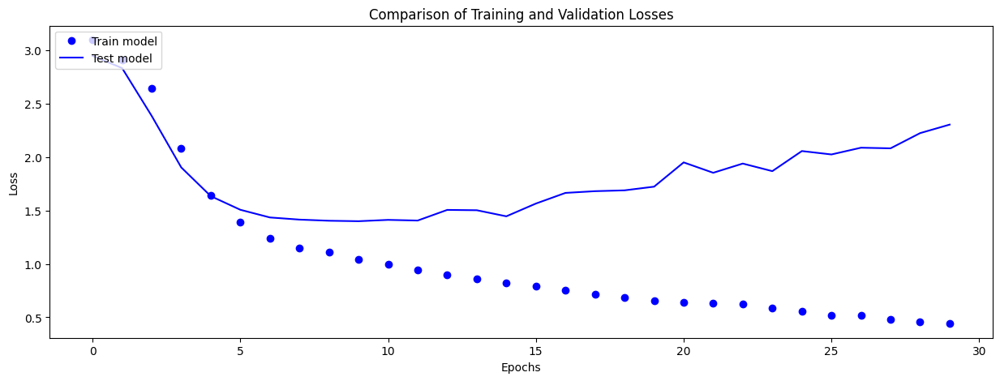

In [34]:
acc_model = history.history['accuracy']
val_acc_model = history.history['val_accuracy']
loss_model = history.history['loss']
val_loss_model = history.history['val_loss']

PlotAccuracyComparison(acc_model, val_acc_model, lab = 'model')
PlotLossComparison(loss_model, val_loss_model, lab = 'model')

Nie ma sensu już dodawać kolejnej warstwy konwolucyjnej, ponieważ shape wyjściowy z ostatniej warstwy Conv byłby już bardzo mały. Model po osiągnięciu skuteczności około 60% zaczyna uczyć się obrazków na pamieć. 60% to około 3 znaki z napisu. Popatrzmy na predykcje na zbiorze testowym i walidacyjnym

### Predykcje

In [35]:
y_pred = model.predict(X_train)

30/30 [==============================] - 1s 10ms/step


In [36]:
y_pred = np.argmax(y_pred, axis=2)

In [37]:
voc = num_to_char.get_vocabulary()

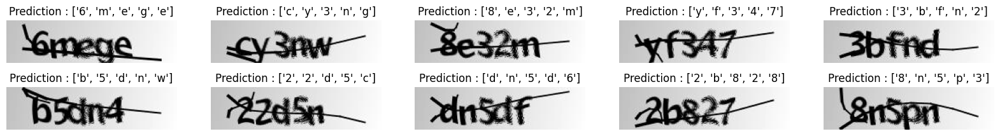

In [38]:
nrow = 1
fig=plt.figure(figsize=(20, 5))
for i in range(0,10):
    if i>4: nrow = 2
    fig.add_subplot(nrow, 5, i+1)
    plt.imshow(X_train[i].transpose([1, 0, 2]),cmap='gray')
    plt.title('Prediction : ' + str(list(map(lambda x:voc[x], y_pred[i]))))
    plt.axis('off')
plt.show() 

O ile na zbiorze treningowym wygląda to dobrze, model zaczął się uczyć na pamięć. Jednak możemy zauważyć, że ma problem z rozpoznaniem ostatniej literu z ciągu znaków. Sprawdźmy jak to wygląda na zbiorze walidacyjnym

4/4 [==============================] - 0s 77ms/step


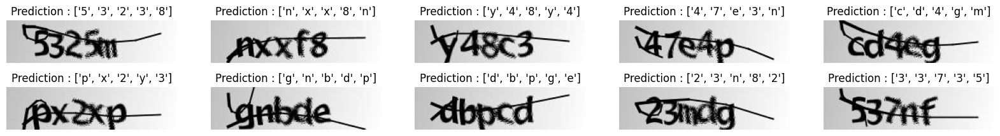

In [39]:
y_pred = model.predict(X_valid)
y_pred = np.argmax(y_pred, axis=2)
nrow = 1
fig=plt.figure(figsize=(20, 5))
for i in range(0,10):
    if i>4: nrow = 2
    fig.add_subplot(nrow, 5, i+1)
    plt.imshow(X_valid[i].transpose([1, 0, 2]),cmap='gray')
    plt.title('Prediction : ' + str(list(map(lambda x:voc[x], y_pred[i]))))
    plt.axis('off')
plt.show() 

Również na zbiorze walidacyjnym możemy dostrzec ten sam problem co na treningowym. Pierwsze znaki są rozpoznawane prawidłowo. Im dalej - tym gorzej. Zwizualizujmy sobie filtry i pośrednie aktywacje:

### Wizualizacje pośrednich aktywacji

In [40]:
array = X_train[0].copy()
array = np.expand_dims(array, axis=0)

1/1 [==============================] - 0s 62ms/step


C:\Users\mstrz\AppData\Local\Temp\ipykernel_11424\964820551.py:43: RuntimeWarning: invalid value encountered in divide
  channel_image /= channel_image.std()
C:\Users\mstrz\AppData\Local\Temp\ipykernel_11424\964820551.py:46: RuntimeWarning: invalid value encountered in cast
  channel_image = np.clip(channel_image, 0, 255).astype('uint8')


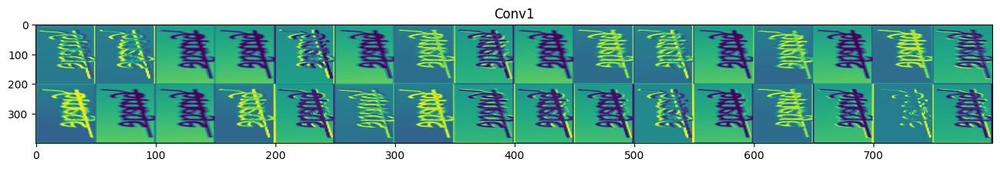

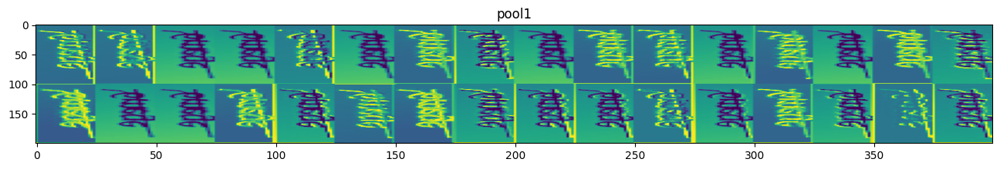

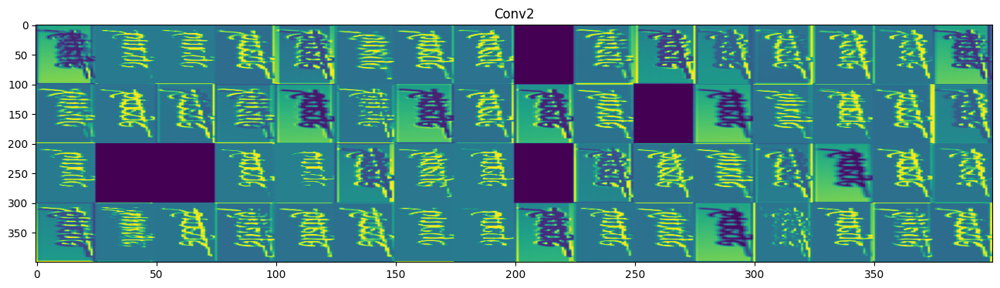

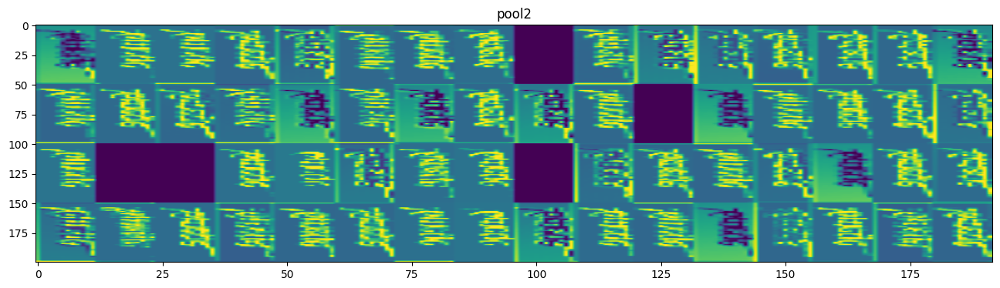

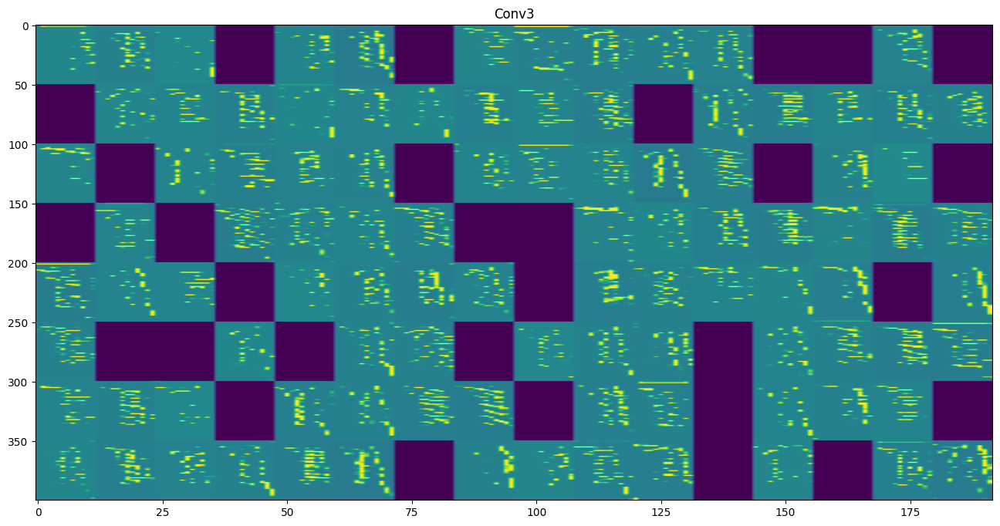

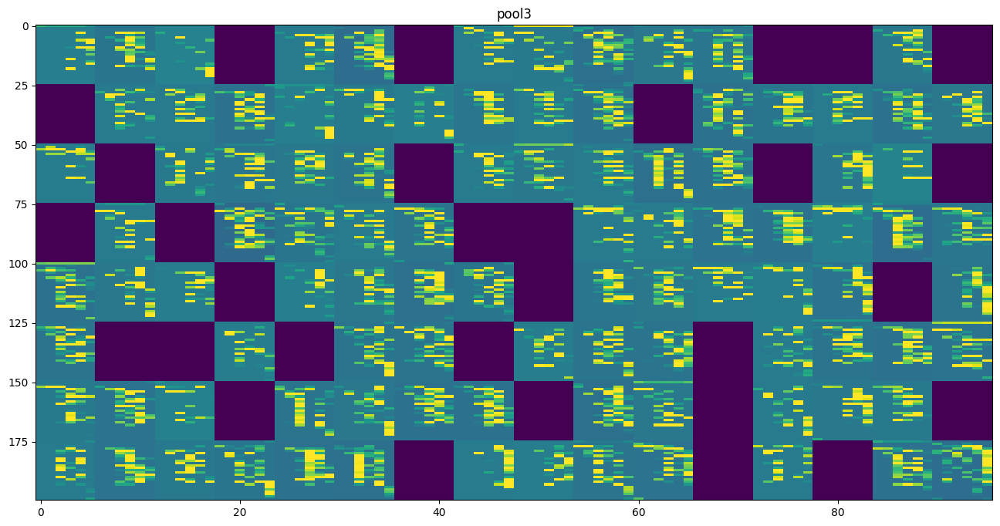

In [43]:
activations_images = output_visualization(model, array, 6)

W 3 warstwie konwolucyjnej dużo filtrów nie jest już aktywowanych przez obraz wyjściowy. Prawdopodobnie więc rozważymy jedynie 2 warstwy konwolucyjne zamiast trzech. Popatrzmy jeszcze jak wyglądają wizualizacje filtrów convnet

## Wizualizacja filtrów convnet
Inną istotną rzeczą dotyczącą sprawdzania filtrów wyuczonych przez convnet jest wyświetlenie ich wzorca wizualnego, na który każdy filtr ma reagować. Można to zrobić za pomocą __wzrostu gradientu w przestrzeni wejściowej__: stosując __spadek gradientu__ do wartości obrazu wejściowego sieci convnet, aby zmaksymalizować odpowiedź określonego filtra, zaczynając od pustego obrazu wejściowego. Wynikowy obraz wejściowy byłby taki, na który wybrany filtr reaguje maksymalnie.

W tym celu zbudujemy funkcję straty, która maksymalizuje wartość danego filtra w danej warstwie konwolucyjnej (splotowej); następnie użyjemy stochastycznego spadku gradientu, aby dostosować wartości obrazu wejściowego tak, aby zmaksymalizować tę wartość aktywacji.

Wybierzemy tylko ostatnią warstwę konwolucyjną, ponieważ utworzenie wszystkich filtrów potrwa zbyt długo

In [44]:
img_width = 200
img_height = 50

layer_name = "Conv3"

layer = model.get_layer(name=layer_name)
feature_extractor = keras.Model(inputs=model.inputs, outputs=layer.output)

W tym celu zbudujemy funkcję straty, która maksymalizuje wartość danego filtra w danej warstwie konwolucyjnej (splotowej); następnie użyjemy stochastycznego spadku gradientu, aby dostosować wartości obrazu wejściowego tak, aby zmaksymalizować tę wartość aktywacji.

In [45]:
def compute_loss(input_image, filter_index):
    activation = feature_extractor(input_image)
    # We avoid border artifacts by only involving non-border pixels in the loss.
    filter_activation = activation[:, 2:-2, 2:-2, filter_index]
    return tf.reduce_mean(filter_activation)

In [46]:
@tf.function
def gradient_ascent_step(img, filter_index, learning_rate):
    with tf.GradientTape() as tape:
        tape.watch(img)
        loss = compute_loss(img, filter_index)
    # Compute gradients.
    grads = tape.gradient(loss, img)
    # Normalize gradients.
    grads = tf.math.l2_normalize(grads)
    img += learning_rate * grads
    return loss, img

Proces wizualizacji:

In [47]:
def initialize_image():
    # We start from a gray image with some random noise
    img = tf.random.uniform((1, img_width, img_height, 1))
    # ResNet50V2 expects inputs in the range [-1, +1].
    # Here we scale our random inputs to [-0.125, +0.125]
    return (img - 0.5) * 0.25


def visualize_filter(filter_index):
    # We run gradient ascent for 20 steps
    iterations = 30
    learning_rate = 10.0
    img = initialize_image()
    for iteration in range(iterations):
        loss, img = gradient_ascent_step(img, filter_index, learning_rate)

    # Decode the resulting input image
    img = deprocess_image(img[0].numpy())
    
    return loss, img


def deprocess_image(img):
    # Normalize array: center on 0., ensure variance is 0.15
    img -= img.mean()
    img /= img.std() + 1e-5
    img *= 0.15

    # Center crop
#     img = img[10:-10, 10:-10, :]

    # Clip to [0, 1]
    img += 0.5
    img = np.clip(img, 0, 1)

    # Convert to RGB array
    img *= 255
    img = np.clip(img, 0, 255).astype("uint8")
    return img

Zwizualizujmy wszystkie filtry na ostatniej warstwie konwolucyjnej

In [48]:
def show_layer_filters(number_of_filters, layer_name):
  # Compute image inputs that maximize per-filter activations
  # for the first 64 filters of our target layer
    print('Processing ' + layer_name)
    all_imgs = []
    for filter_index in range(number_of_filters):
        print("Processing filter %d" % (filter_index,))
        loss, img = visualize_filter(filter_index)
        all_imgs.append(img)

    # Build a black picture with enough space for
    # our 8 x 8 filters of size 128 x 128, with a 5px margin in between
    margin = 5
    cols = 8
    rows = int(number_of_filters/cols)
    cropped_width = 50 - 0 * 2
    cropped_height = 200 - 0 * 2
    width = cols * cropped_width + (cols) * margin
    height = rows * cropped_height + (rows) * margin
    stitched_filters = np.zeros((height, width, 1))
    print(stitched_filters.shape)
    # Fill the picture with our saved filters
    for i in range(rows):
        for j in range(cols):
            img = all_imgs[i * cols + j]
            stitched_filters[
              (cropped_height + margin) * i : (cropped_height + margin) * i + cropped_height,
              (cropped_width + margin) * j : (cropped_width + margin) * j
              + cropped_width,
              :,
            ] = img
    fig, ax = plt.subplots(figsize=(30, 30))
    ax.imshow(stitched_filters.astype(np.uint8))
    ax.set_title(layer_name)
    ax.axis('off')

Processing Conv1
Processing filter 0
Processing filter 1
Processing filter 2
Processing filter 3
Processing filter 4
Processing filter 5
Processing filter 6
Processing filter 7
Processing filter 8
Processing filter 9
Processing filter 10
Processing filter 11
Processing filter 12
Processing filter 13
Processing filter 14
Processing filter 15
Processing filter 16
Processing filter 17
Processing filter 18
Processing filter 19
Processing filter 20
Processing filter 21
Processing filter 22
Processing filter 23
Processing filter 24
Processing filter 25
Processing filter 26
Processing filter 27
Processing filter 28
Processing filter 29
Processing filter 30
Processing filter 31
(820, 440, 1)
Processing pool1
Processing filter 0
Processing filter 1
Processing filter 2
Processing filter 3
Processing filter 4
Processing filter 5
Processing filter 6
Processing filter 7
Processing filter 8
Processing filter 9
Processing filter 10
Processing filter 11
Processing filter 12
Processing filter 13
Proces

Processing filter 67
Processing filter 68
Processing filter 69
Processing filter 70
Processing filter 71
Processing filter 72
Processing filter 73
Processing filter 74
Processing filter 75
Processing filter 76
Processing filter 77
Processing filter 78
Processing filter 79
Processing filter 80
Processing filter 81
Processing filter 82
Processing filter 83
Processing filter 84
Processing filter 85
Processing filter 86
Processing filter 87
Processing filter 88
Processing filter 89
Processing filter 90
Processing filter 91
Processing filter 92
Processing filter 93
Processing filter 94
Processing filter 95
Processing filter 96
Processing filter 97
Processing filter 98
Processing filter 99
Processing filter 100
Processing filter 101
Processing filter 102
Processing filter 103
Processing filter 104
Processing filter 105
Processing filter 106
Processing filter 107
Processing filter 108
Processing filter 109
Processing filter 110
Processing filter 111
Processing filter 112
Processing filter 113

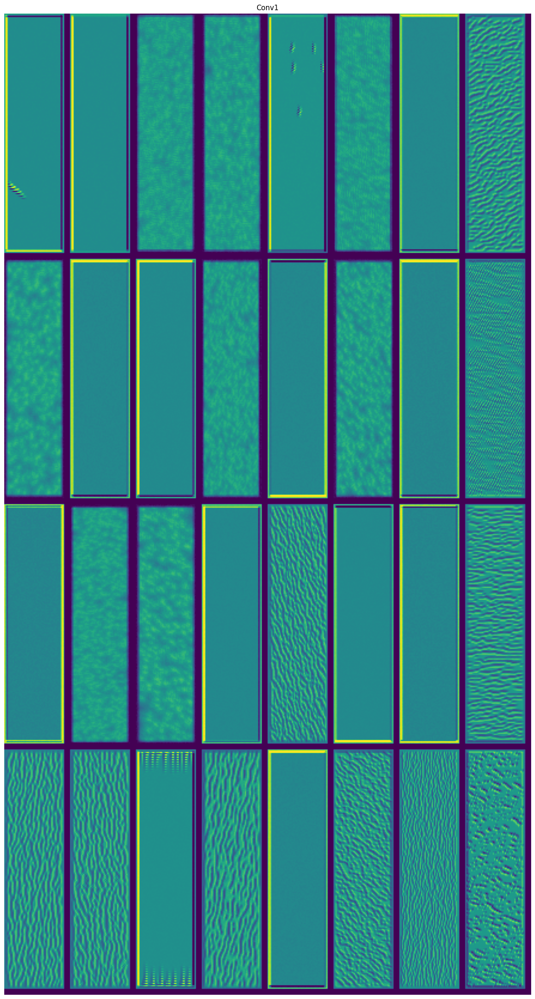

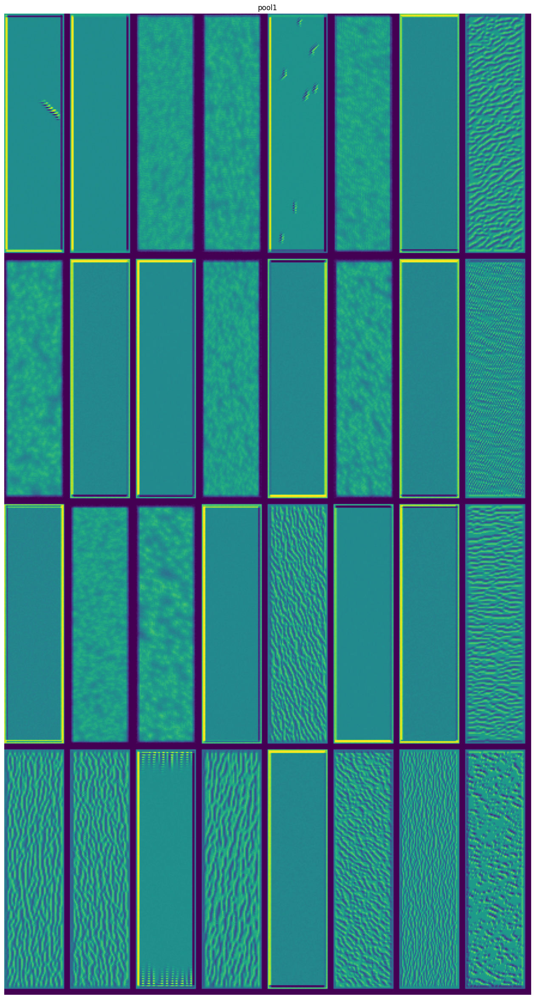

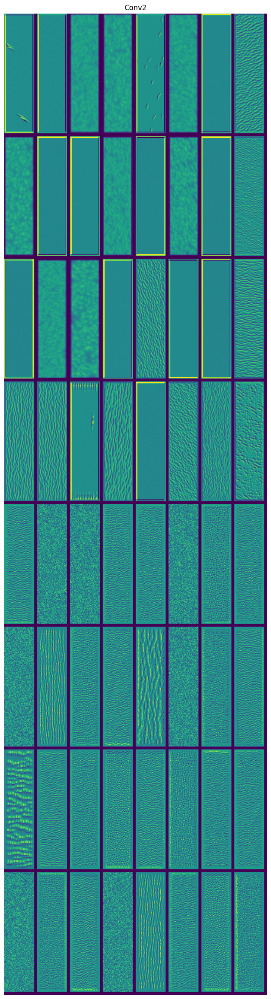

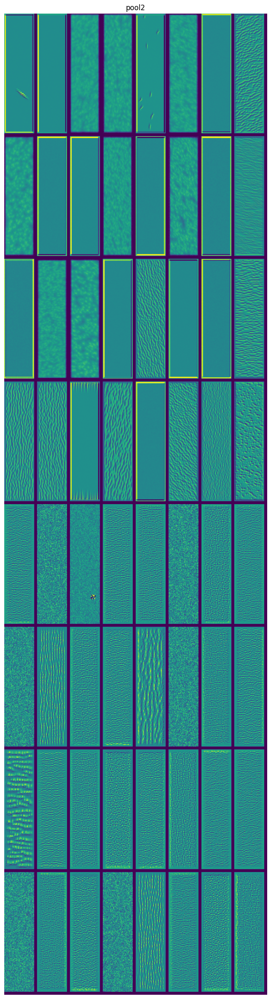

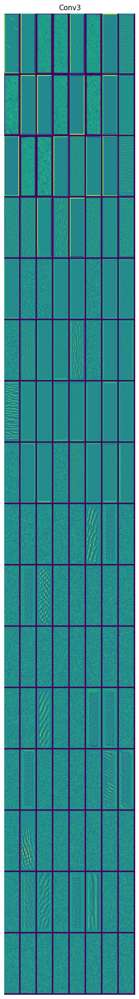

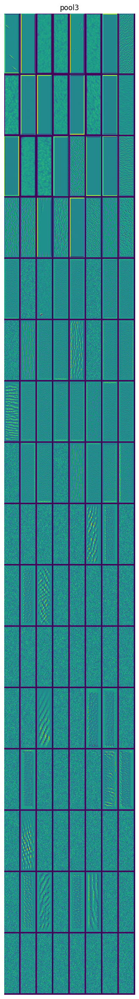

In [50]:
layers_names = []
for layer in model.layers[:6]:
      layers_names.append(layer.name)

for layer_name in layers_names:
        layer = model.get_layer(name=layer_name)
        feature_extractor = keras.Model(inputs=model.inputs, outputs=layer.output)
        show_layer_filters(layer.output_shape[3], layer_name)
plt.show()

Patrząc na powyższe wizualizacje filtrów możemy dostrzec, że są one różnorodne i wykrywają różne wzorce do drugiej warstwy. Gdy popatrzymy na warstwę Conv3 dostrzeżemy, że dużo filtrów nie wykrywa nic. Potwierdziło to nasze przypuszczenia z wizualiacji wyjść. Jednak w modelu z dwoma warstwami konwolucyjnymi i tak nasz model zatrzymał się na 60% na zbiorze walidacyjnym. Wygląda na to, że trzeba poszukać problemu z overfittingiem gdzieś indziej. Popatrzmy na obrazy raz jeszcze
#### Zbiór treningowy

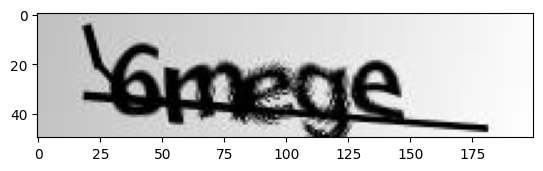

In [51]:
plt.imshow(X_train[0].transpose([1, 0, 2]), cmap='gray')
plt.show()

#### Zbiór walidacyjny

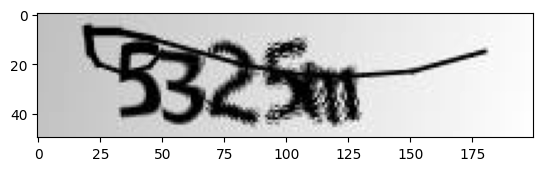

In [52]:
plt.imshow(X_valid[0].transpose([1,0,2]), cmap='gray')
plt.show()

#### Wyniki dla zbioru walidacyjny

4/4 [==============================] - 0s 72ms/step


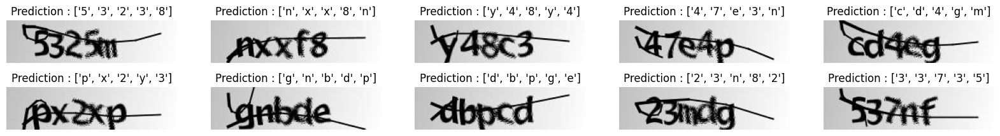

In [53]:
y_pred = model.predict(X_valid)
y_pred = np.argmax(y_pred, axis=2)
nrow = 1
fig=plt.figure(figsize=(20, 5))
for i in range(10):
    if i>4: nrow = 2
    fig.add_subplot(nrow, 5, i+1)
    plt.imshow(X_valid[i].transpose([1, 0, 2]),cmap='gray')
    plt.title('Prediction : ' + str(list(map(lambda x:voc[x], y_pred[i]))))
    plt.axis('off')
plt.show() 

Widzimy, że dwa/trzy pierwsze znaki są poprawnie rozpoznawane. Natomiast przy końcowej części pojawiają się problemy. Może mieć na to wpływ to, że po drugiej warstwie konwolucyjnej robimy reshape na 5 obszarów obrazu. Przez to ostatnie dwa mogą nie zawierać prawidłowego znaku i model nie potrafi się ich nauczyć. Wtedy zaczyna występować overfitting, ponieważ sieć zaczyna uczyć się na pamięć, a wyniki na zbiorze walidacyjnym zatrzymują się, ponieważ model jest w stanie rozpoznać jedynie około 3/5 części napisu

### Przycięcie wejściowego obrazu
Sprawdźmy czy przycięcie wejściowego obrazu faktycznie ma wpływ na nasze wyniki na zbiorze walidacyjnym. Na początek weźmy przykładowy obraz, żeby ustalić na ile przycinać te napisy:

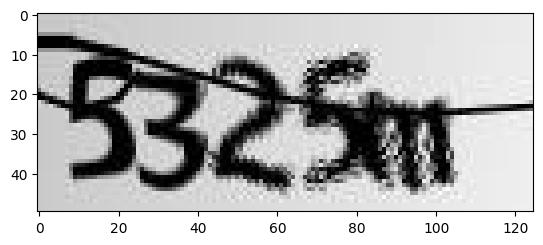

In [54]:
image = X_valid[0].transpose([1, 0, 2])
image = tf.image.crop_to_bounding_box(image, offset_height=0, offset_width=25, target_height=50, target_width=125)
plt.imshow(image, 'gray')

I przywróćmy do tego samego rozmiaru:

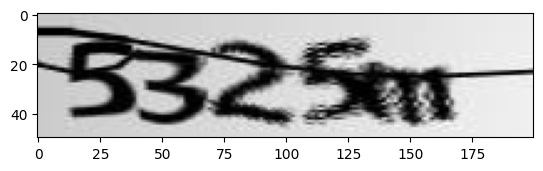

In [55]:
image = tf.image.resize(image, size=[50,200], method='bilinear', preserve_aspect_ratio=False,antialias=False, name=None)
plt.imshow(image, 'gray')

### Rozbudujmy funkcję encodującą dane

In [56]:
def encode_single_sample(img_path, label):
    img = tf.io.read_file(img_path)
    img = tf.io.decode_png(img, channels=1)
    img = tf.image.convert_image_dtype(img, tf.float32)
    img = tf.image.resize(img, [img_height, img_width])
    # Wytnijmy wyraz z obrazka
    img = tf.image.crop_to_bounding_box(img, offset_height=0, offset_width=25, target_height=50, target_width=125)
    img = tf.image.resize(img, size=[50,200], method='bilinear', preserve_aspect_ratio=False,antialias=False, name=None)
    img = tf.transpose(img, perm=[1, 0, 2])
    label = char_to_num(tf.strings.unicode_split(label, input_encoding="UTF-8"))
    return img, label

### Ponowne nauczenie modelu
Przystąpmy do ponownego treningu tym razem z lepiej przygotowanymi obrazkami:

In [57]:
x_train, x_valid, y_train, y_valid = split_data(np.array(images_paths), np.array(labels))
def create_dataset(paths, labels):
    X , y =[], []
    for i in range(paths.shape[0]):
        img, label = encode_single_sample(paths[i], labels[i])
        X.append(img)
        y.append(label)
    X = np.array(X)
    y = np.array(y)
    return X, y

X_train, y_train = create_dataset(x_train, y_train)
X_valid, y_valid = create_dataset(x_valid, y_valid)

#### Czy na pewno zostały przycięte?

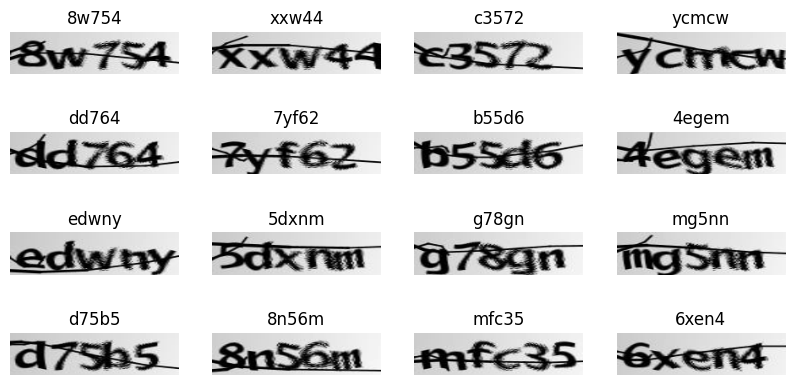

In [58]:
_, ax = plt.subplots(4, 4, figsize=(10, 5))
for i in range(16):
    img = (X_train[i] * 255).astype("uint8")
    label = tf.strings.reduce_join(num_to_char(y_train[i])).numpy().decode("utf-8")
    ax[i // 4, i % 4].imshow(img.transpose([1, 0, 2]), cmap="gray")
    ax[i // 4, i % 4].set_title(label)
    ax[i // 4, i % 4].axis("off")
plt.show()

In [59]:
def build_model():
    
    model = keras.Sequential()

    model.add(layers.Conv2D(32, (3, 3), activation="relu", padding="same", name="Conv1", input_shape=X_train.shape[1:]))
    model.add(layers.MaxPooling2D((2, 2), name="pool1"))
    
    model.add(layers.Conv2D(64, (3, 3), activation="relu", padding="same", name="Conv2"))
    model.add(layers.MaxPooling2D((2, 2), name="pool2"))

    model.add(layers.Reshape(target_shape=(5, 7680), name="reshape"))

    model.add(layers.Dense(256, activation="relu", name="dense1"))
    model.add(layers.Dense(128, activation="relu", name="dense2"))
    model.add(layers.Dense(36, activation="softmax", name="dense3")) 
    
    model.compile(optimizer=keras.optimizers.Adam(), loss="sparse_categorical_crossentropy", metrics="accuracy")
    return model


model = build_model()
model.summary()

Model: "sequential_8"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 Conv1 (Conv2D)              (None, 200, 50, 32)       320       
                                                                 
 pool1 (MaxPooling2D)        (None, 100, 25, 32)       0         
                                                                 
 Conv2 (Conv2D)              (None, 100, 25, 64)       18496     
                                                                 
 pool2 (MaxPooling2D)        (None, 50, 12, 64)        0         
                                                                 
 reshape (Reshape)           (None, 5, 7680)           0         
                                                                 
 dense1 (Dense)              (None, 5, 256)            1966336   
                                                                 
 dense2 (Dense)              (None, 5, 128)           

In [60]:
history = model.fit(X_train, y_train,
                    validation_data=(X_valid, y_valid),
                    batch_size=32,
                    epochs=30)

Epoch 1/30
30/30 [==============================] - 1s 25ms/step - loss: 2.7215 - accuracy: 0.1974 - val_loss: 1.9042 - val_accuracy: 0.4346
Epoch 2/30
30/30 [==============================] - 1s 17ms/step - loss: 1.3073 - accuracy: 0.6109 - val_loss: 0.9317 - val_accuracy: 0.7096
Epoch 3/30
30/30 [==============================] - 1s 17ms/step - loss: 0.7291 - accuracy: 0.7923 - val_loss: 0.5947 - val_accuracy: 0.8077
Epoch 4/30
30/30 [==============================] - 1s 17ms/step - loss: 0.5045 - accuracy: 0.8515 - val_loss: 0.4814 - val_accuracy: 0.8423
Epoch 5/30
30/30 [==============================] - 1s 17ms/step - loss: 0.3930 - accuracy: 0.8885 - val_loss: 0.3790 - val_accuracy: 0.8788
Epoch 6/30
30/30 [==============================] - 1s 18ms/step - loss: 0.3100 - accuracy: 0.9060 - val_loss: 0.3940 - val_accuracy: 0.8558
Epoch 7/30
30/30 [==============================] - 1s 17ms/step - loss: 0.2615 - accuracy: 0.9186 - val_loss: 0.2927 - val_accuracy: 0.9115
Epoch 8/30
30

<Figure size 640x480 with 0 Axes>

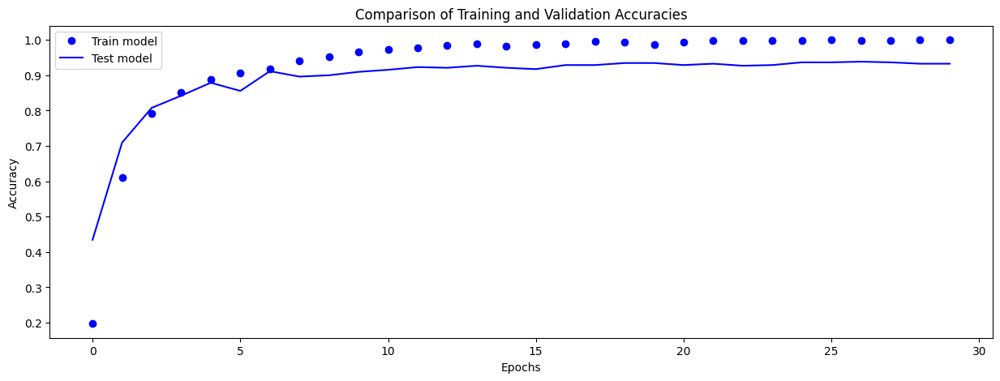

<Figure size 640x480 with 0 Axes>

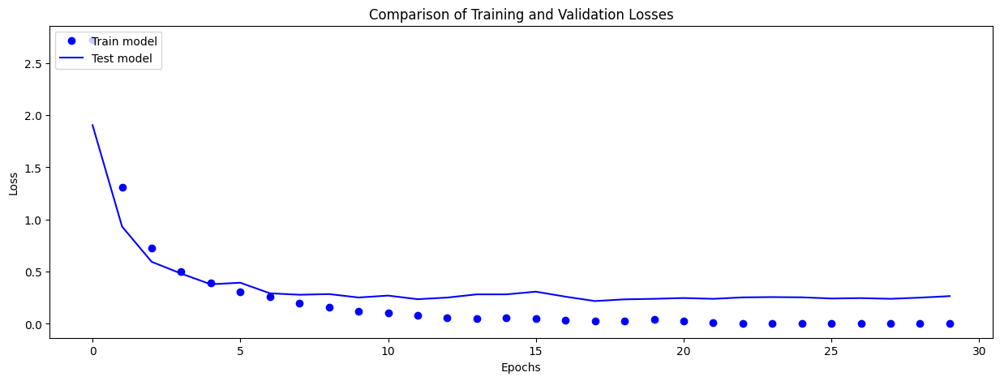

In [61]:
acc_model = history.history['accuracy']
val_acc_model = history.history['val_accuracy']
loss_model = history.history['loss']
val_loss_model = history.history['val_loss']

PlotAccuracyComparison(acc_model, val_acc_model, lab = 'model')
PlotLossComparison(loss_model, val_loss_model, lab = 'model')

Faktycznie, nasze przypuszczenia były zasadne. Po przycięciu obrazków sieć przestała się przeuczać i na zbiorze walidacyjnym osiągnęła satysfakcjonujący wynik na poziomie 93%. Przy czym warto zwrócić uwagę, że zbiór walidacyjny zawiera jedynie 104 przykłady. Zobaczmy na przykładach czy końcówki napisów są już poprawnie rozpoznawane:

4/4 [==============================] - 0s 70ms/step


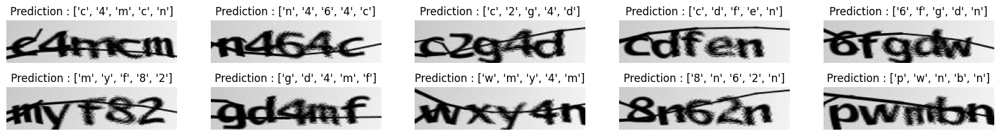

In [62]:
y_pred = model.predict(X_valid)
y_pred = np.argmax(y_pred, axis=2)
nrow = 1
fig=plt.figure(figsize=(20, 5))
for i in range(0,10):
    if i>4: nrow = 2
    fig.add_subplot(nrow, 5, i+1)
    plt.imshow(X_valid[i].transpose([1, 0, 2]),cmap='gray')
    plt.title('Prediction : ' + str(list(map(lambda x:voc[x], y_pred[i]))))
    plt.axis('off')
plt.show() 

Teraz ostatnie dwa/trzy znaki są rozpoznawane poprawnie

## Podsumowanie
W tym notebooku został wypracowany model składający się z warstw konwolucyjnych oraz warstw głębokich, który potrafi rozpoznawać rysunki Captcha ze skutecznością na poziomie 93% na zbiorze walidacyjnym. Jego problemem jest jednak, że nie radzi sobie z białymi przestrzeniami oraz potrzebuje znać liczbę znaków w napisie. W następnym notebooku zostanie podjęcia próba rozwiązania tych problemów dzięki modelowi RCNN(CNN + RNN). Również zostaną przedstawione wnioski i porównanie tych dwóch podejść.